# UMAP MODEL 

In [3]:
import numpy as np 
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn import preprocessing

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
import plotly.express as px

from sklearn import metrics
import math

sns.set(style='white', context='notebook', rc={'figure.figsize':(14,10)})

ModuleNotFoundError: No module named 'plotly'

In [2]:
import umap

ModuleNotFoundError: No module named 'umap'


## DATA LOADING


This notebook goal is building a model based on UMAP dimensionallity reduction to predict the Remaining Useful Life of a certain instance.

On this purpose, first a UMAP projection is going to be built.

Once we have the projection, we apply it over the new point that we would like to predict. This point, in case that the projection results are good enough, will be near to other instances in a similar health situation.

The last step is selecting a number of "nearest neighbours", based on the two new axes, and predicting as the final outcome the remaining useful life of those. 

In [5]:
train2 = pd.read_csv("C:/Users/eduardo.tadeo/Documents/Master Thesis/Datasets/CMAPSSData/train_FD001.txt", delimiter = ',')
test2  = pd.read_csv("C:/Users/eduardo.tadeo/Documents/Master Thesis/Datasets/CMAPSSData/test_FD001.txt", delimiter = ',')


In [6]:
train2.head()

,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN,NaN,NaN


In [7]:
RUL_test = pd.read_csv("C:/Users/eduardo.tadeo/Documents/Master Thesis/Datasets/CMAPSSData/RUL_FD001.txt")

In [8]:
RUL_test.head()

,RUL
0,112
1,98
2,69
3,82
4,91


In [9]:
for i in range(train2['Unit'].max()):

    train_Unit = train2[train2['Unit']==(i+1)]

    UL = train_Unit['Cycle'].max() # UsefulLife

    train2.loc[train2['Unit']==i+1, 'UL'] = UL
    train2.loc[train2['Unit']==i+1, 'RUL'] = UL - train2.loc[train2['Unit']==i+1, 'Cycle'] 
    train2.loc[train2['Unit']==i+1, 'RUL_index'] = train2.loc[train2['Unit']==i+1, 'RUL'] / train2.loc[train2['Unit']==i+1, 'UL']
     

In [10]:
train2.head(100)

,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC,UL,RUL,RUL_index
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,100.0,39.06,23.4190,NaN,NaN,NaN,NaN,192.0,191.0,0.994792
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,100.0,39.00,23.4236,NaN,NaN,NaN,NaN,192.0,190.0,0.989583
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,100.0,38.95,23.3442,NaN,NaN,NaN,NaN,192.0,189.0,0.984375
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,100.0,38.88,23.3739,NaN,NaN,NaN,NaN,192.0,188.0,0.979167
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,100.0,38.90,23.4044,NaN,NaN,NaN,NaN,192.0,187.0,0.973958
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1,96,-0.0034,0.0001,100.0,518.67,642.19,1584.07,1395.16,14.62,...,100.0,38.88,23.3255,NaN,NaN,NaN,NaN,192.0,96.0,0.500000
96,1,97,0.0035,-0.0003,100.0,518.67,642.07,1595.77,1407.81,14.62,...,100.0,39.01,23.2963,NaN,NaN,NaN,NaN,192.0,95.0,0.494792
97,1,98,0.0006,0.0004,100.0,518.67,642.00,1591.11,1404.56,14.62,...,100.0,38.96,23.2554,NaN,NaN,NaN,NaN,192.0,94.0,0.489583
98,1,99,-0.0005,-0.0000,100.0,518.67,642.46,1592.73,1406.13,14.62,...,100.0,38.82,23.2323,NaN,NaN,NaN,NaN,192.0,93.0,0.484375


In [11]:
train2.tail(400)

,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC,UL,RUL,RUL_index
20231,98,142,0.0062,0.0002,100.0,518.67,643.59,1597.32,1419.68,14.62,...,100.0,38.69,23.2351,NaN,NaN,NaN,NaN,156.0,14.0,0.089744
20232,98,143,0.0007,0.0004,100.0,518.67,643.07,1597.23,1430.24,14.62,...,100.0,38.74,23.1984,NaN,NaN,NaN,NaN,156.0,13.0,0.083333
20233,98,144,0.0006,0.0003,100.0,518.67,643.61,1596.57,1419.65,14.62,...,100.0,38.63,23.1630,NaN,NaN,NaN,NaN,156.0,12.0,0.076923
20234,98,145,-0.0022,-0.0004,100.0,518.67,643.02,1596.19,1425.81,14.62,...,100.0,38.52,23.1740,NaN,NaN,NaN,NaN,156.0,11.0,0.070513
20235,98,146,0.0009,-0.0002,100.0,518.67,642.88,1594.90,1423.26,14.62,...,100.0,38.62,23.1121,NaN,NaN,NaN,NaN,156.0,10.0,0.064103
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,100.0,38.49,22.9735,NaN,NaN,NaN,NaN,200.0,4.0,0.020000
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,100.0,38.30,23.1594,NaN,NaN,NaN,NaN,200.0,3.0,0.015000
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,100.0,38.44,22.9333,NaN,NaN,NaN,NaN,200.0,2.0,0.010000
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,100.0,38.29,23.0640,NaN,NaN,NaN,NaN,200.0,1.0,0.005000


In [12]:
train2[train2['RUL']<0]

,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC,UL,RUL,RUL_index


In [13]:
test2[test2['Unit']==1].tail()


,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC
26,1,27,-0.0007,0.0001,100.0,518.67,642.08,1586.65,1400.31,14.62,...,0.03,392,2388,100.0,38.87,23.3931,NaN,NaN,NaN,NaN
27,1,28,0.0022,0.0005,100.0,518.67,641.93,1594.25,1401.29,14.62,...,0.03,392,2388,100.0,38.83,23.3502,NaN,NaN,NaN,NaN
28,1,29,0.0014,0.0001,100.0,518.67,641.95,1587.15,1398.11,14.62,...,0.03,392,2388,100.0,39.02,23.3621,NaN,NaN,NaN,NaN
29,1,30,-0.0025,0.0004,100.0,518.67,642.79,1585.72,1400.97,14.62,...,0.03,391,2388,100.0,39.09,23.4069,NaN,NaN,NaN,NaN
30,1,31,-0.0006,0.0004,100.0,518.67,642.58,1581.22,1398.91,14.62,...,0.03,393,2388,100.0,38.81,23.3552,NaN,NaN,NaN,NaN


In [14]:
RUL_test.head()

,RUL
0,112
1,98
2,69
3,82
4,91


### DATA VECTOR PREPARATION

On this stage, I am going to prepare the data vectors that we are using as input for the UMAP projection.


In [15]:
train_vector = train2.iloc[:,2:-7]

In [16]:
train_vector.head()

,OP1,OP2,OP3,T2,T24,T30,T50,P2,P15,P30,...,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32
0,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [17]:
test_vector = test2.iloc[:,2:-4]

test_vector.head()

,OP1,OP2,OP3,T2,T24,T30,T50,P2,P15,P30,...,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32
0,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,...,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,...,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,...,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,...,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,...,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


In [18]:
test_lastcycle = np.zeros((test2['Unit'].max(), len(test_vector.columns)))

for i in range(test2['Unit'].max()):

    test_unit = test2[test2['Unit'] == i+1]
   # print(test_unit)

    last = test_unit[test_unit['Cycle'] == test_unit['Cycle'].max()]
    test_lastcycle[i,:] = last.iloc[:,2:-4].to_numpy()

In [19]:
test_lastcycle = pd.DataFrame(test_lastcycle, columns = test_vector.columns)

In [20]:
test_lastcycle

,OP1,OP2,OP3,T2,T24,T30,T50,P2,P15,P30,...,phi,NRf,NRc,BPR,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32
0,-0.0006,0.0004,100.0,518.67,642.58,1581.22,1398.91,14.62,21.61,554.42,...,521.79,2388.06,8130.11,8.4024,0.03,393.0,2388.0,100.0,38.81,23.3552
1,0.0018,-0.0001,100.0,518.67,642.55,1586.59,1410.83,14.62,21.61,553.52,...,521.74,2388.09,8126.90,8.4505,0.03,391.0,2388.0,100.0,38.81,23.2618
2,-0.0016,0.0004,100.0,518.67,642.88,1589.75,1418.89,14.62,21.61,552.59,...,520.83,2388.14,8131.46,8.4119,0.03,395.0,2388.0,100.0,38.93,23.2740
3,0.0012,0.0004,100.0,518.67,642.78,1594.53,1406.88,14.62,21.61,552.64,...,521.88,2388.11,8133.64,8.4634,0.03,395.0,2388.0,100.0,38.58,23.2581
4,-0.0013,-0.0004,100.0,518.67,642.27,1589.94,1419.36,14.62,21.61,553.29,...,521.00,2388.15,8125.74,8.4362,0.03,394.0,2388.0,100.0,38.75,23.4117
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,-0.0006,0.0003,100.0,518.67,642.30,1590.88,1397.94,14.62,21.61,553.99,...,522.30,2388.01,8148.24,8.4110,0.03,391.0,2388.0,100.0,38.96,23.4606
96,0.0013,-0.0001,100.0,518.67,642.59,1582.96,1410.92,14.62,21.61,554.05,...,521.58,2388.06,8155.48,8.4500,0.03,395.0,2388.0,100.0,38.61,23.2953
97,0.0017,0.0001,100.0,518.67,642.68,1599.51,1415.47,14.62,21.61,553.44,...,521.53,2388.09,8146.39,8.4235,0.03,394.0,2388.0,100.0,38.76,23.3608
98,0.0047,-0.0000,100.0,518.67,642.00,1585.03,1397.98,14.62,21.61,554.75,...,521.82,2388.02,8150.38,8.4003,0.03,391.0,2388.0,100.0,38.95,23.3595


In [21]:
test2.tail()

,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,farB,htBleed,Nf_dmd,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC
13091,100,194,0.0049,0.0000,100.0,518.67,643.24,1599.45,1415.79,14.62,...,0.03,394,2388,100.0,38.65,23.1974,NaN,NaN,NaN,NaN
13092,100,195,-0.0011,-0.0001,100.0,518.67,643.22,1595.69,1422.05,14.62,...,0.03,395,2388,100.0,38.57,23.2771,NaN,NaN,NaN,NaN
13093,100,196,-0.0006,-0.0003,100.0,518.67,643.44,1593.15,1406.82,14.62,...,0.03,395,2388,100.0,38.62,23.2051,NaN,NaN,NaN,NaN
13094,100,197,-0.0038,0.0001,100.0,518.67,643.26,1594.99,1419.36,14.62,...,0.03,395,2388,100.0,38.66,23.2699,NaN,NaN,NaN,NaN
13095,100,198,0.0013,0.0003,100.0,518.67,642.95,1601.62,1424.99,14.62,...,0.03,396,2388,100.0,38.70,23.1855,NaN,NaN,NaN,NaN


## UMAP MODEL FITTING

In [22]:
train_v = (train_vector.to_numpy())
test_v = (test_lastcycle.to_numpy())

In [23]:
print(train_v.shape, test_v.shape)

(20631, 24) (100, 24)


In [24]:
RUL_train = train2['RUL'].to_numpy()


In [25]:
train2.head()


,Unit,Cycle,OP1,OP2,OP3,T2,T24,T30,T50,P2,...,PCNfR_dmd,W31,W32,T_EGT,SmFan,SmLPC,SmHPC,UL,RUL,RUL_index
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,100.0,39.06,23.4190,NaN,NaN,NaN,NaN,192.0,191.0,0.994792
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,100.0,39.00,23.4236,NaN,NaN,NaN,NaN,192.0,190.0,0.989583
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,100.0,38.95,23.3442,NaN,NaN,NaN,NaN,192.0,189.0,0.984375
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,100.0,38.88,23.3739,NaN,NaN,NaN,NaN,192.0,188.0,0.979167
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,100.0,38.90,23.4044,NaN,NaN,NaN,NaN,192.0,187.0,0.973958


In [26]:
trans = umap.UMAP(n_components=2, n_neighbors=15, min_dist=0.25, metric='chebyshev').fit(train_v) # Projection calculation
train_emb = trans.embedding_ # Projection over the euclidean space
test_emb = trans.transform(test_v) # Projection test data set over the euclidean space

C:\Users\eduardo.tadeo\Anaconda3\envs\UMAP\lib\site-packages\ipykernel_launcher.py:20: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



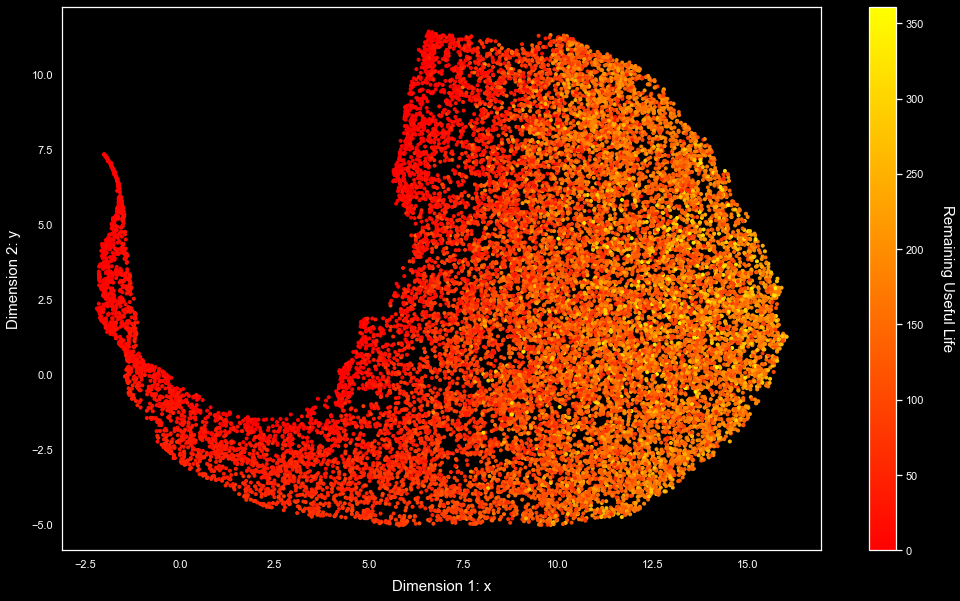

In [27]:
plt.style.use('dark_background')

fig = plt.figure(figsize = (17,10) )

ax = fig.add_subplot(111)
plot = ax.scatter(train_emb[:,0], train_emb[:,1], c = train2['RUL'], cmap= 'autumn', marker = '.', label = 'Useful Lifetime')

ax.set_xlabel("Dimension 1: x", size = 15, labelpad = 10)
ax.set_ylabel("Dimension 2: y", size = 15, labelpad = 10)
ax.tick_params(colors = 'white')


cbar = plt.colorbar(plot)

cbar.ax.set_ylabel('Remaining Useful Life', rotation = 270, size = 15, labelpad = +30)




fig.show()

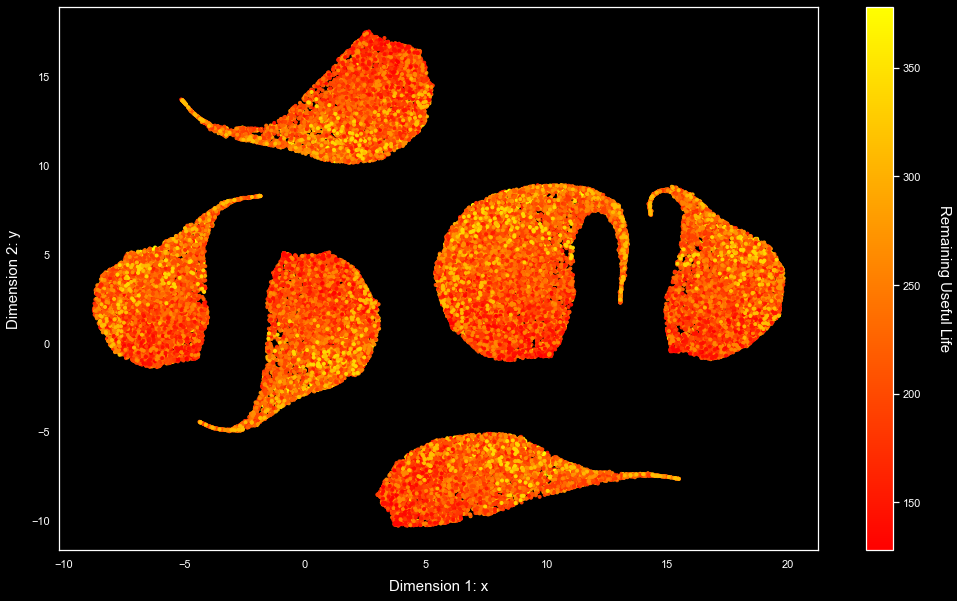

In [26]:
plt.style.use('dark_background')

fig = plt.figure(figsize = (17,10) )

ax = fig.add_subplot(111)
plot = ax.scatter(train_emb[:,0], train_emb[:,1], c = train2['UL'], cmap= 'autumn', marker = '.', label = 'Useful Lifetime')

ax.set_xlabel("Dimension 1: x", size = 15, labelpad = 10)
ax.set_ylabel("Dimension 2: y", size = 15, labelpad = 10)
ax.tick_params(colors = 'white')


cbar = plt.colorbar(plot)

cbar.ax.set_ylabel('Remaining Useful Life', rotation = 270, size = 15, labelpad = +30)




fig.show()

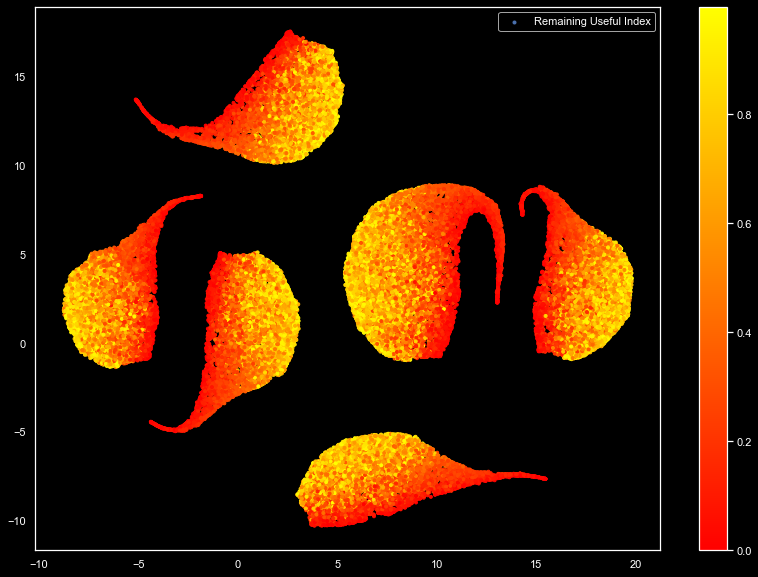

In [27]:
plt.style.use('dark_background')

plt.scatter(train_emb[:,0], train_emb[:,1], c = train2['RUL_index'], cmap= 'autumn', marker = '.', label = 'Remaining Useful Index')

plt.colorbar()
plt.xticks()
plt.yticks()
plt.legend()

In [28]:
NN = 5

distances = metrics.pairwise_distances(test_emb,train_emb)

RUL_predict = np.zeros(len(test_emb))
RUL_index_predict = np.zeros(len(test_emb))

for i in range(len(test_emb)):

    print('Unidad:', i)

    maxs = np.zeros(NN)

    dist = np.zeros((len(train_emb),2))
    dist[:,0] = range(len(train_emb))
    dist[:,1] = distances[i,:]

    #display(dist)
    #print(dist.shape)

    #display(np.sort(dist[:,1]))

    for j in range(NN):

        #print(np.argmin(dist[:,1]))
        #print(dist[np.argmin(dist[:,1]),1])
        

        maxs[j] = dist[np.argmin(dist[:,1]),0]

        dist = np.delete(dist, obj = np.argmin(dist[:,1]), axis = 0)
    
    RUL_predict[i] = round(np.mean(RUL_train[maxs.astype(int)]))

    #print("Maxs: ", maxs)
    #print(RUL_train[maxs.astype(int)])

Unidad: 0
Unidad: 1
Unidad: 2
Unidad: 3
Unidad: 4
Unidad: 5
Unidad: 6
Unidad: 7
Unidad: 8
Unidad: 9
Unidad: 10
Unidad: 11
Unidad: 12
Unidad: 13
Unidad: 14
Unidad: 15
Unidad: 16
Unidad: 17
Unidad: 18
Unidad: 19
Unidad: 20
Unidad: 21
Unidad: 22
Unidad: 23
Unidad: 24
Unidad: 25
Unidad: 26
Unidad: 27
Unidad: 28
Unidad: 29
Unidad: 30
Unidad: 31
Unidad: 32
Unidad: 33
Unidad: 34
Unidad: 35
Unidad: 36
Unidad: 37
Unidad: 38
Unidad: 39
Unidad: 40
Unidad: 41
Unidad: 42
Unidad: 43
Unidad: 44
Unidad: 45
Unidad: 46
Unidad: 47
Unidad: 48
Unidad: 49
Unidad: 50
Unidad: 51
Unidad: 52
Unidad: 53
Unidad: 54
Unidad: 55
Unidad: 56
Unidad: 57
Unidad: 58
Unidad: 59
Unidad: 60
Unidad: 61
Unidad: 62
Unidad: 63
Unidad: 64
Unidad: 65
Unidad: 66
Unidad: 67
Unidad: 68
Unidad: 69
Unidad: 70
Unidad: 71
Unidad: 72
Unidad: 73
Unidad: 74
Unidad: 75
Unidad: 76
Unidad: 77
Unidad: 78
Unidad: 79
Unidad: 80
Unidad: 81
Unidad: 82
Unidad: 83
Unidad: 84
Unidad: 85
Unidad: 86
Unidad: 87
Unidad: 88
Unidad: 89
Unidad: 90
Unidad: 9

In [29]:
print(RUL_predict)

[188. 109.  68. 181.  80. 152.  52. 130. 113. 235. 106.  51.  98. 133.
 148. 117.  33.  55. 135.  40.  83. 137. 154.  21. 138. 148. 168. 114.
  89.  94.  25.  50. 109.  10.  13.  63.  70.  76. 144.  23.  72.  13.
  64. 135.  74.  43. 178. 140.  17. 147. 127.  26.  28. 186. 163.  48.
 152.  32. 154. 104.  84.  44. 111.  55. 168.  15. 124.   7. 121. 124.
 167.  95. 160. 165. 162.  20.  50. 172. 186. 103.  11.   6. 140. 133.
 157. 116. 188. 167. 154.  48.  16.  61.  26.  59. 207. 140.  76.  52.
 177.   4.]


In [30]:
print(RUL_predict.shape, RUL_test.to_numpy().shape)

(100,) (100, 1)


In [31]:
error = RUL_predict - RUL_test.to_numpy()[:,0]
abs_error = np.absolute(error)
mean_error = np.mean(abs_error)


print("Mean RUL error: " , mean_error )



Mean RUL error:  30.85


In [32]:
test_lastcycle['RUL_predict'] = RUL_predict
test_lastcycle['RUL_test'] = RUL_test
test_lastcycle['error'] = error
test_lastcycle['Absolute_error'] = abs_error
test_lastcycle['Embedding_x'] = test_emb[:,0]
test_lastcycle['Embedding_y'] = test_emb[:,1]



In [33]:
print(test_lastcycle[test_lastcycle['Absolute_error'] > 30])
print(len(test_lastcycle[test_lastcycle['Absolute_error'] > 30]))


       OP1     OP2    OP3      T2     T24      T30      T50     P2    P15  \
0  -0.0006  0.0004  100.0  518.67  642.58  1581.22  1398.91  14.62  21.61   
3   0.0012  0.0004  100.0  518.67  642.78  1594.53  1406.88  14.62  21.61   
5   0.0076 -0.0003  100.0  518.67  643.05  1586.94  1404.49  14.62  21.61   
6   0.0016 -0.0001  100.0  518.67  642.10  1589.59  1413.57  14.62  21.61   
7   0.0016 -0.0005  100.0  518.67  642.59  1591.91  1413.89  14.62  21.61   
9  -0.0018  0.0004  100.0  518.67  643.00  1589.50  1398.99  14.62  21.61   
11  0.0013  0.0003  100.0  518.67  642.59  1595.90  1409.64  14.62  21.61   
14 -0.0012 -0.0000  100.0  518.67  642.49  1589.21  1400.61  14.62  21.61   
15 -0.0005  0.0002  100.0  518.67  642.99  1587.03  1401.00  14.62  21.61   
18  0.0004  0.0003  100.0  518.67  642.79  1588.88  1406.32  14.62  21.61   
22 -0.0006  0.0003  100.0  518.67  642.03  1588.77  1403.06  14.62  21.61   
26  0.0038  0.0005  100.0  518.67  642.56  1586.56  1407.16  14.62  21.61   

In [34]:
print(error)

error.shape

[ 76.  11.  -1.  99. -11.  59. -39.  35.   2. 139.   9. -73.   3.  26.
  65.  33. -17.  27.  48.  24.  26.  26.  41.   1.  -7.  29. 102.  17.
  -1. -21.  17.   2.   3.   3.   2.  44.  49.  26.   2.  -5.  54.   3.
   5.  26. -40.  -4.  43.  48.  -4.  68.  13.  -3.   2.  89.  26.  33.
  49.  -5.  40.   4.  63. -10.  39.  27.  40.   1.  47.  -1.   0.  30.
  49.  45.  29.  39.  49.  10.  16.  65. 123.  13.   3.  -3.   3.  75.
  39.  27.  72.  52.  18.  20. -22.  41. -59.   4.  79.   3.  -6.  -7.
  60. -16.]


(100,)

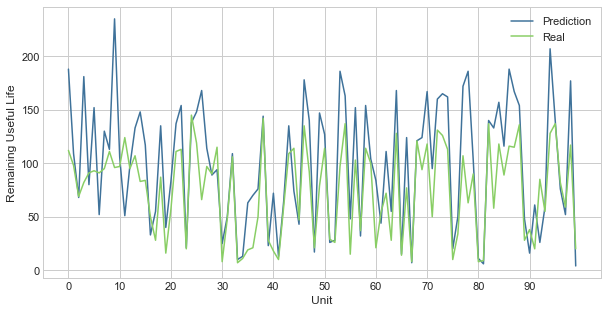

In [38]:
plt.style.use('seaborn-whitegrid')

plt.figure(figsize = (10,5))
plt.plot(range(len(test_emb)), RUL_predict, color = "#3f729a", label = 'Prediction')
plt.plot(range(len(test_emb)), RUL_test, color = "#89ce65", label = 'Real')
#plt.plot(range(len(test_emb[:130])), abs_error[:130], color = 'red', label = 'Error')

plt.ylabel('Remaining Useful Life')
plt.xlabel('Unit')

plt.xticks(range(0,100,10))

plt.legend()

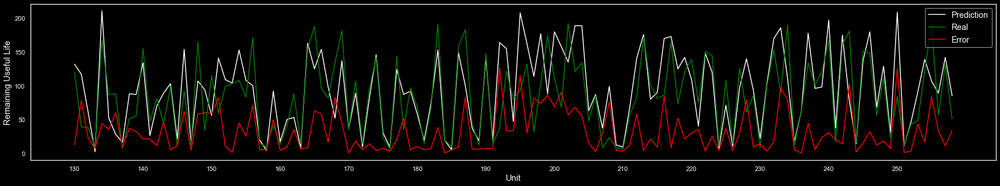

In [63]:
plt.figure(figsize = (30,5))
plt.plot(range(130, len(test_emb)), RUL_predict[130:], color = 'white', label = 'Prediction')
plt.plot(range(130, len(test_emb)), RUL_test[130:], color = 'green', label = 'Real')
plt.plot(range(130, len(test_emb)), abs_error[130:], color = 'red', label = 'Error')

plt.ylabel('Remaining Useful Life', size = 15)
plt.xlabel('Unit', size = 15)

plt.xticks(range(130,260,10))

plt.legend(fontsize = 'large')


In [36]:
distances = metrics.pairwise_distances(test_emb,train_emb)

display(distances)

print(distances.shape)

array([[ 7.4481597, 10.333197 ,  5.9399896, ..., 12.222022 , 12.222346 ,
        17.975208 ],
       [23.30375  , 16.264755 , 17.497612 , ...,  7.10249  ,  7.1022143,
        25.988081 ],
       [ 3.9127045,  7.712074 , 16.424381 , ..., 19.089325 , 19.089613 ,
         8.108721 ],
       ...,
       [ 7.293995 ,  6.7844687, 18.683802 , ..., 19.5724   , 19.572655 ,
         4.9925327],
       [20.420757 , 13.13978  , 15.971708 , ...,  5.960897 ,  5.960724 ,
        22.87013  ],
       [18.246313 ,  9.354179 , 18.703365 , ..., 11.03122  , 11.031222 ,
        17.34446  ]], dtype=float32)

(259, 53759)


In [37]:
print(math.sqrt((test_emb[0,0]-train_emb[1,0])**2 + (test_emb[0,1]-train_emb[1,1])**2 ))

10.33319646282589


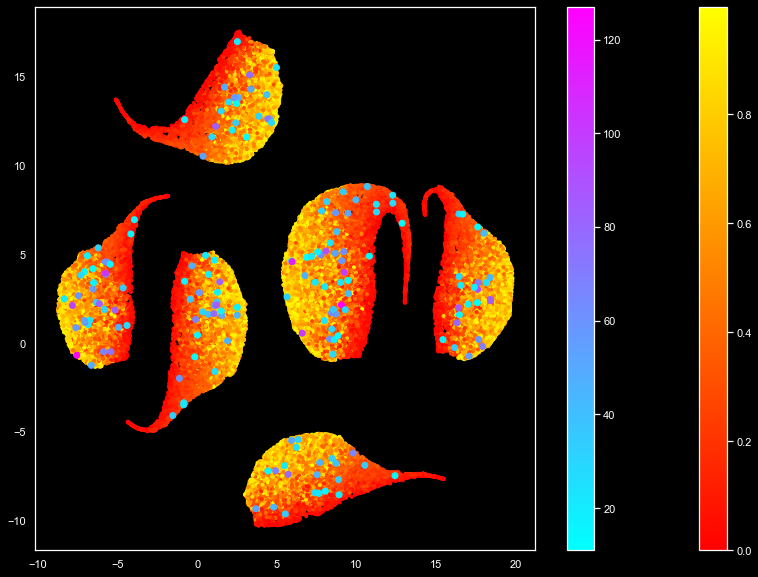

In [38]:
plt.style.use('dark_background')

plt.scatter(train_emb[:,0], train_emb[:,1], c = train2['RUL_index'], cmap= 'autumn', marker = '.', label = 'Train')

plt.colorbar()
plt.scatter(test_lastcycle[test_lastcycle['Absolute_error'] > 10]['Embedding_x'], test_lastcycle[test_lastcycle['Absolute_error'] > 10]['Embedding_y'], c = test_lastcycle[test_lastcycle['Absolute_error'] > 10]['Absolute_error'] , cmap = 'cool', marker= 'o')
plt.colorbar()

Text(0.5, 0, 'Predicted value')

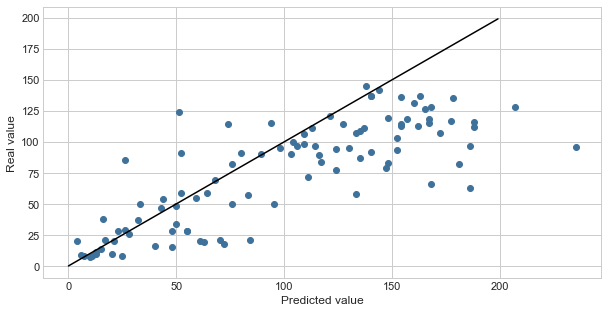

In [54]:
fig = plt.figure(figsize = (10,5))

ax = fig.add_subplot(111)

ax.scatter(RUL_predict, RUL_test, c = "#3f729a", marker = 'o')
ax.plot(range(200), range(200), c = 'black')

ax.set_ylabel('Real value')
ax.set_xlabel('Predicted value')

#### SCORE METRIC

In [40]:
s = np.zeros(len(RUL_predict))

a_1 = 10
a_2 = 13

for i in range(len(error)):

    if error[i] < 0 : 

        s[i] = math.exp(-error[i]/a_1) - 1 
    else : 
        s[i] = math.exp(error[i]/a_2) - 1

performance_evaluation = np.sum(s)

print('The model performance evaluation is:', performance_evaluation)



The model performance evaluation is: 129158.43259788255


[3.34139339e+01 6.97987763e+00 2.21402758e-01 4.58126678e+01
 2.00416602e+00 5.84197836e+00 5.68589444e+00 4.02428793e+02
 5.95591312e+03 1.63021907e+02 3.65741950e+00 8.95429270e+03
 8.02501350e+00 1.36424809e+02 3.44901429e+02 7.13368881e-01
 5.68589444e+00 2.24259915e+01 4.37011845e+01 1.16828570e+02
 7.99589994e-02 1.85936546e+02 7.26997937e+01 6.48721271e-01
 6.26784470e+01 2.63220019e+01 1.45960311e+00 1.45960311e+00
 7.26997937e+01 4.37011845e+01 4.02982210e+00 3.49858808e-01
 7.61794066e+00 2.21402758e-01 2.24259915e+01 2.53286488e+02
 1.26250024e+02 9.85488691e+00 4.58126678e+01 2.02817506e+03
 2.63220019e+01 7.13368881e-01 8.97418245e+00 1.08104670e+02
 1.11824940e+01 1.22554093e+00 2.61126389e+01 6.77701119e+01
 5.84197836e+00 2.73618982e+02 2.43691932e+02 3.60282376e-01
 1.15810553e+00 1.45960311e+00 6.38905610e+00 3.60282376e-01
 1.33289780e+02 5.04964746e+00 4.43200164e+00 3.49858808e-01
 4.02428793e+02 7.26997937e+01 8.96847292e+02 5.86512897e-01
 2.24259915e+01 1.051709

In [52]:
test_lastcycle[test_lastcycle['Absolute_error'] < 10 ]['RUL_test'].mean()

45.63414634146341

In [39]:
def Computed_Score(y_true, y_pred):
    ##Computed score used in the challenge

    a1 = 10
    a2 = 13
    score = 0
    d = y_pred - y_true

    for i in d: 
        if i<0:
            score += (e**(-i/a1) - 1)
        else : 
            score += (e**(i/a2) - 1)
    
    return score


In [52]:
from math import e
Computed_Score(RUL_test.to_numpy()[:,0],RUL_predict)

67304.54902399845

In [47]:
print(RUL_test.shape,RUL_predict.shape)

(100, 1) (100,)


In [50]:
RUL_test.to_numpy()[:,0]

array([112,  98,  69,  82,  91,  93,  91,  95, 111,  96,  97, 124,  95,
       107,  83,  84,  50,  28,  87,  16,  57, 111, 113,  20, 145, 119,
        66,  97,  90, 115,   8,  48, 106,   7,  11,  19,  21,  50, 142,
        28,  18,  10,  59, 109, 114,  47, 135,  92,  21,  79, 114,  29,
        26,  97, 137,  15, 103,  37, 114, 100,  21,  54,  72,  28, 128,
        14,  77,   8, 121,  94, 118,  50, 131, 126, 113,  10,  34, 107,
        63,  90,   8,   9, 137,  58, 118,  89, 116, 115, 136,  28,  38,
        20,  85,  55, 128, 137,  82,  59, 117,  20], dtype=int64)